# Import and set colors

In [1]:
import scanpy as sc
import anndata as ann
import numpy as np
import scipy as sp
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import cm, colors
from gprofiler import gprofiler

import os 
#pretty plotting
import seaborn as sb


In [2]:
#Define a nice colour map for gene expression
colors2 = plt.cm.plasma(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7,0.8,20))
colorsComb = np.vstack([colors3, colors2])
mymap2 = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

In [3]:
plt.rcParams['figure.figsize']=(5,5) #rescale figures
sc.settings.verbosity = 3
sc.set_figure_params(scanpy=True, dpi=100, dpi_save=300,transparent=True, fontsize=12, color_map=mymap2)
sc.logging.print_header()

scanpy==1.7.1 anndata==0.7.6 umap==0.5.1 numpy==1.21.2 scipy==1.8.1 pandas==1.2.3 scikit-learn==0.24.1 statsmodels==0.12.2 python-igraph==0.8.3 louvain==0.7.0 leidenalg==0.8.3 pynndescent==0.5.4


# Set project file paths

We set up the file paths to the respective directories.

In [4]:
file_path = '/Volumes/Seagate_Exp/Paper_sc_analysis/' 
#this is my file path please adapt it to your directory

In [5]:
data_dir = '/Volumes/Seagate_Exp/Paper_sc_analysis/notebooks/analysis_early_time_points/040522_corrected_notebooks/data_scVI/' 

In [6]:
table_dir = '/Volumes/Seagate_Exp/Paper_sc_analysis/notebooks/analysis_early_time_points/040522_corrected_notebooks/Paper_figures/220713/Figure4/221219/'

In [7]:
sc.settings.figdir = '/Volumes/Seagate_Exp/Paper_sc_analysis/notebooks/analysis_early_time_points/040522_corrected_notebooks/Paper_figures/220713/Figure4/221219/'

In [8]:
import datetime

today = datetime.date.today().strftime('%y%m%d') #creates a YYMMDD string of today's date

# Astrocytes

In [9]:
adata_all_astros_proc = sc.read(data_dir + '220713adata_ctr_astros_proc_scVI.h5ad')

In [10]:
#Filter genes:
print('Total number of genes: {:d}'.format(adata_all_astros_proc.n_vars))

# Min 20 cells - filters out 0 count genes
sc.pp.filter_genes(adata_all_astros_proc, min_cells=20)
print('Number of genes after cell filter: {:d}'.format(adata_all_astros_proc.n_vars))

Total number of genes: 19290
filtered out 4548 genes that are detected in less than 20 cells
Number of genes after cell filter: 14742


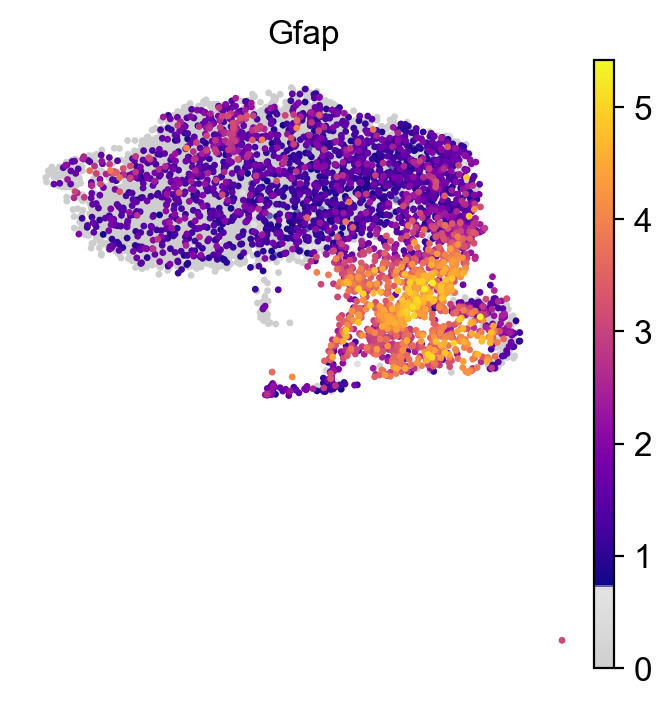

In [11]:
sc.pl.umap(adata_all_astros_proc, color=['Gfap'], frameon=False, wspace=0.5,cmap=mymap2, size=24)

In [12]:
set(adata_all_astros_proc.obs['condition'])

{'3dpi_V', '5dpi_V', 'Intact'}

In [13]:
# use scVI latent space for UMAP generation
sc.pp.neighbors(adata_all_astros_proc, use_rep="X_scVI")

computing neighbors


OMP: Info #271: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:06)


In [14]:
sc.tl.umap(adata_all_astros_proc)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:10)


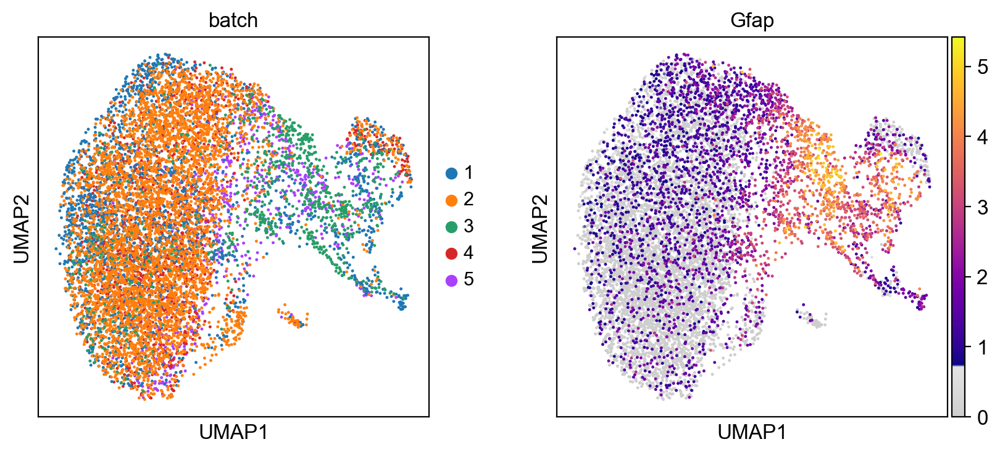

In [15]:
sc.pl.umap(adata_all_astros_proc, color=['batch','Gfap',])

In [16]:
sc.tl.leiden(adata_all_astros_proc, key_added='leiden_astros_r1')
sc.tl.leiden(adata_all_astros_proc, resolution=0.5, key_added='leiden_astros_r0.5')

running Leiden clustering
    finished: found 14 clusters and added
    'leiden_astros_r1', the cluster labels (adata.obs, categorical) (0:00:01)
running Leiden clustering
    finished: found 9 clusters and added
    'leiden_astros_r0.5', the cluster labels (adata.obs, categorical) (0:00:01)


In [17]:
sc.tl.leiden(adata_all_astros_proc, resolution=0.4, key_added='leiden_astros_r0.6')

running Leiden clustering
    finished: found 8 clusters and added
    'leiden_astros_r0.6', the cluster labels (adata.obs, categorical) (0:00:00)


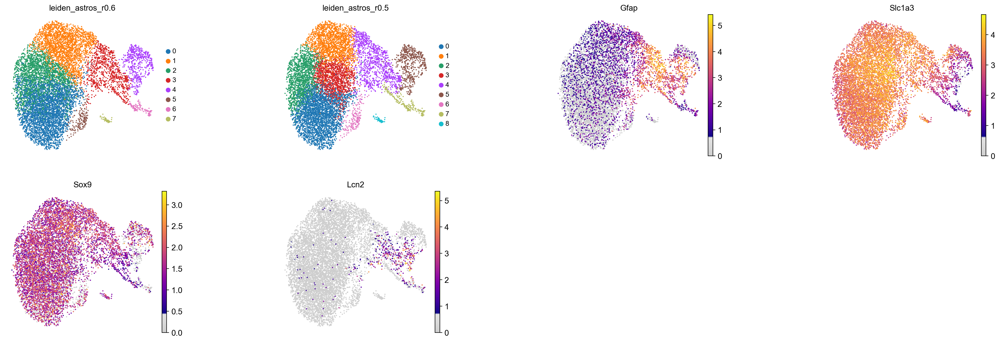

In [18]:
sc.pl.umap(adata_all_astros_proc, color=['leiden_astros_r0.6','leiden_astros_r0.5' ,'Gfap', 'Slc1a3','Sox9','Lcn2'], legend_fontsize =float(10),
           wspace=0.6, legend_fontweight= 'normal', frameon= False,cmap=mymap2  )

In [19]:
sc.tl.rank_genes_groups(adata_all_astros_proc, groupby='leiden_astros_r0.6', key_added='rank_genes_astros_r0.6', method='t-test_overestim_var', use_raw=True)

ranking genes
    finished: added to `.uns['rank_genes_astros_r0.6']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)


    using 'X_pca' with n_pcs = 9
Storing dendrogram info using `.uns['dendrogram_leiden_astros_r0.6']`


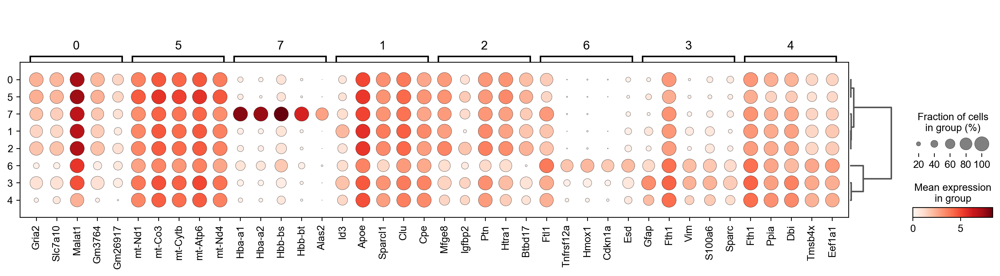

In [20]:
sc.pl.rank_genes_groups_dotplot(adata_all_astros_proc, n_genes=5, key='rank_genes_astros_r0.6')

In [21]:
sc.tl.rank_genes_groups(adata_all_astros_proc, groupby='leiden_astros_r0.5', key_added='rank_genes_astros_r0.5', method='t-test_overestim_var', use_raw=True)

ranking genes
    finished: added to `.uns['rank_genes_astros_r0.5']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)


    using 'X_pca' with n_pcs = 9
Storing dendrogram info using `.uns['dendrogram_leiden_astros_r0.5']`


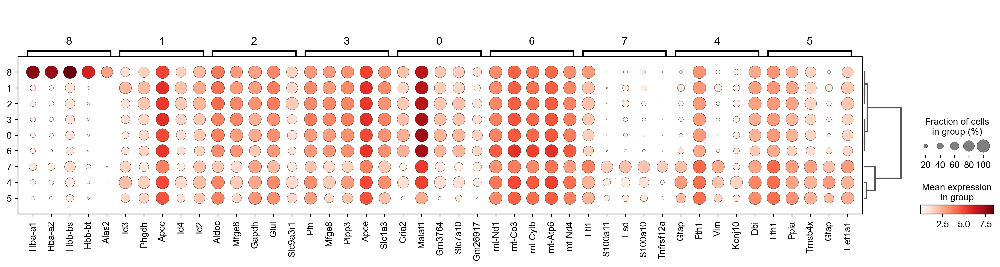

In [22]:
sc.pl.rank_genes_groups_dotplot(adata_all_astros_proc, n_genes=5, key='rank_genes_astros_r0.5')

In [23]:
adata_all_astros_proc.write(data_dir+today + "adata_ctr_astros_proc_clusters_scVI.h5ad")

# Plots figures

In [24]:
adata_all_astros_proc=sc.read(data_dir + "220713adata_ctr_astros_proc_clusters_scVI.h5ad")

In [25]:
clustersA= ['#4da6ff',# 0
             '#b3d9ff',# 1
             '#4169E1',# 2
             '#bdcbf5',#3
             '#ff6666',# 4
             '#DC143C',# 5
             '#92a8d1',# 6
             '#ffb399',#7
             '#333399'
              ]

In [26]:
cluster2annotation = {
    '0': 'AG1',
    '1': 'AG2',
    '2': 'AG3',
    '3': 'AG4',
    '4': 'AG5',
    '5': 'AG6',
    '6': 'AG7',
    '7': 'AG8',
    '8': 'AG9',
    }

In [27]:
adata_all_astros_proc.obs['clustersastros'] = adata_all_astros_proc.obs['leiden_astros_r0.5'].map(cluster2annotation).astype('category')

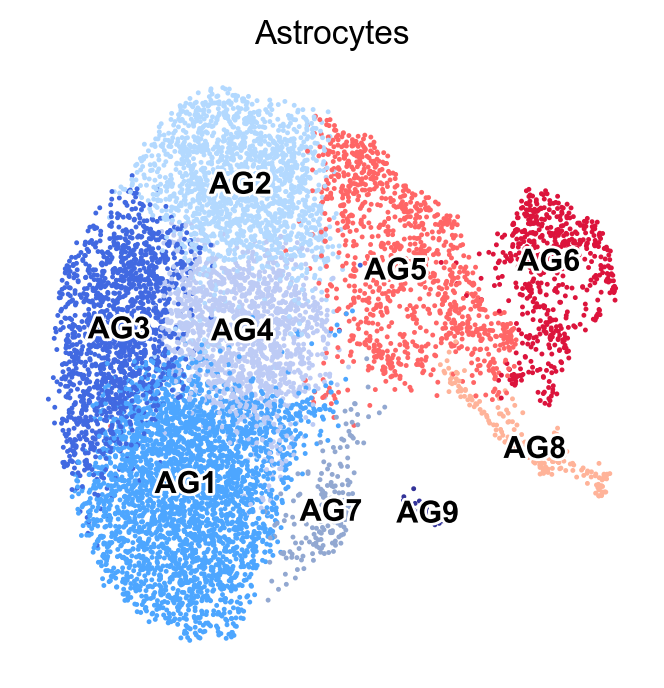

In [28]:
sc.pl.umap(adata_all_astros_proc, color=['clustersastros'],title='Astrocytes',legend_fontoutline=2,legend_loc='on data',legend_fontsize =float(11),
           wspace=0.6, legend_fontweight= 'black', frameon= False,palette=clustersA   )

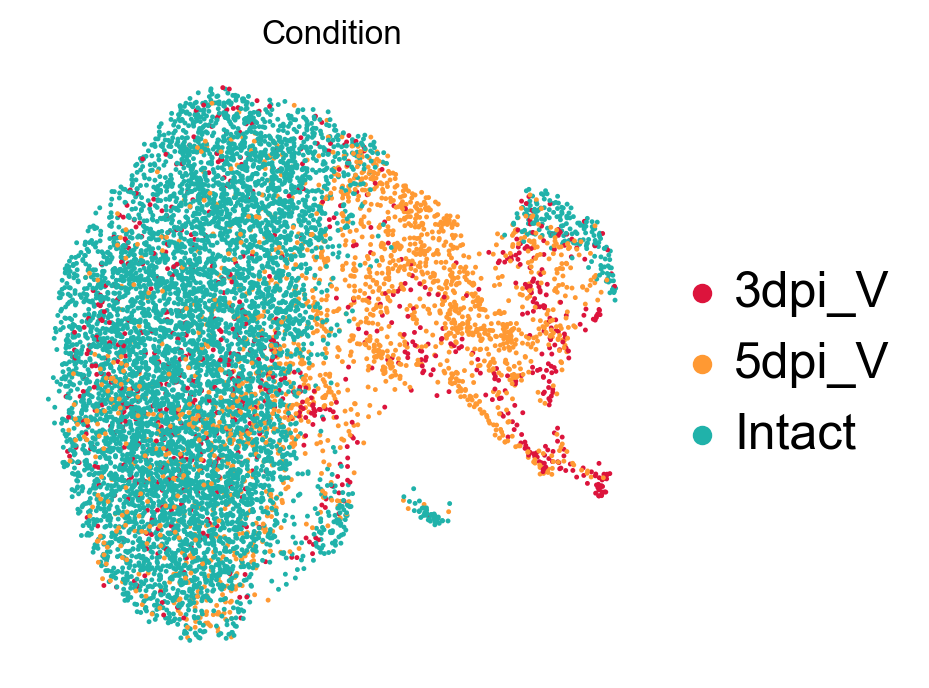

In [29]:
sc.pl.umap(adata_all_astros_proc, color=['condition'], legend_fontsize =float(18),  legend_fontweight= 'normal', title= 'Condition',
           frameon= False, save='_3A_condition.png' )

In [30]:
print(adata_all_astros_proc.obs['condition'].value_counts())

Intact    6824
5dpi_V    1992
3dpi_V     842
Name: condition, dtype: int64


In [31]:
intact_subsam = sc.pp.subsample(adata_all_astros_proc[adata_all_astros_proc.obs['condition']=='Intact'],n_obs=842,copy=True).obs_names
five_dpi_V_subsam = sc.pp.subsample(adata_all_astros_proc[adata_all_astros_proc.obs['condition']=='5dpi_V'],n_obs=842,copy=True).obs_names
three_dpi_V_subsam = sc.pp.subsample(adata_all_astros_proc[adata_all_astros_proc.obs['condition']=='3dpi_V'],n_obs=842,copy=True).obs_names
adata_all_astros_proc_subsam = adata_all_astros_proc[list(intact_subsam) + list(five_dpi_V_subsam)+list(three_dpi_V_subsam)].copy()

In [32]:
sc.tl.embedding_density(adata_all_astros_proc_subsam, basis='umap', groupby='condition')

computing density on 'umap'
--> added
    'umap_density_condition', densities (adata.obs)
    'umap_density_condition_params', parameter (adata.uns)


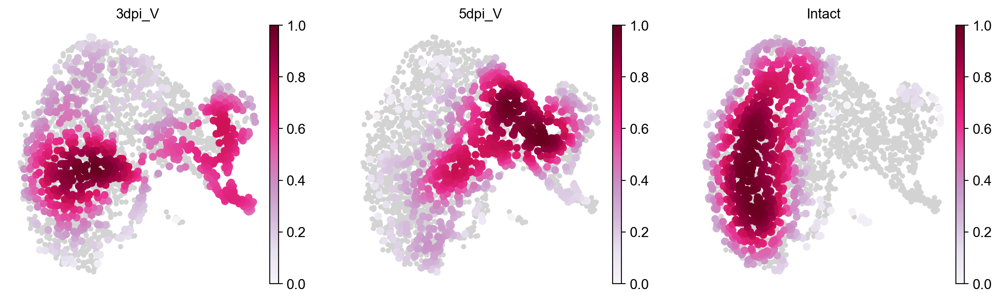

In [33]:
sc.pl.embedding_density(adata_all_astros_proc_subsam, basis='umap',  key='umap_density_condition', color_map='PuRd', frameon= False, ncols=5, save='_distribution_downscaling_astros.png')

In [34]:
sc.tl.rank_genes_groups(adata_all_astros_proc, groupby='clustersastros', key_added='rank_genes_astros_clustersastros', method='t-test_overestim_var', use_raw=True)

ranking genes
    finished: added to `.uns['rank_genes_astros_clustersastros']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)


    using 'X_pca' with n_pcs = 9
Storing dendrogram info using `.uns['dendrogram_clustersastros']`


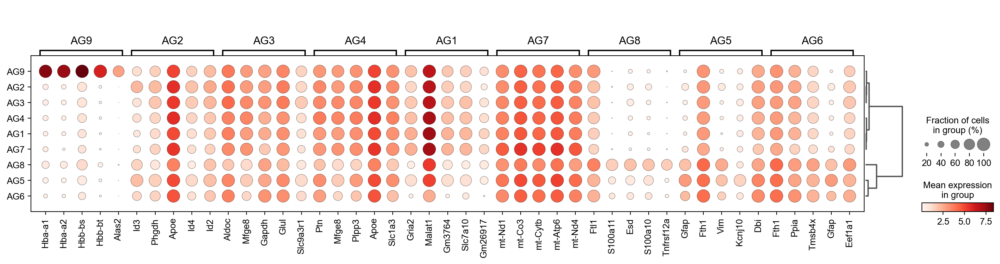

In [35]:
sc.pl.rank_genes_groups_dotplot(adata_all_astros_proc, n_genes=5, key='rank_genes_astros_clustersastros', cmap='Reds', save='rank_astros.png')

In [36]:
result = adata_all_astros_proc.uns['rank_genes_astros_clustersastros']
groups = result['names'].dtype.names
adata_clastros_genes = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names','scores', 'pvals','logfoldchanges']})

In [37]:
adata_clastros_genes

,AG1_n,AG1_s,AG1_p,AG1_l,AG2_n,AG2_s,AG2_p,AG2_l,AG3_n,AG3_s,...,AG7_p,AG7_l,AG8_n,AG8_s,AG8_p,AG8_l,AG9_n,AG9_s,AG9_p,AG9_l
0,Gria2,48.962589,0.000000e+00,1.730397,Id3,32.105106,2.682270e-197,2.101952,Aldoc,26.699766,...,2.277898e-53,1.528214,Ftl1,22.404804,5.697277e-70,2.766390,Hba-a1,49.957947,2.186518e-63,12.516623
1,Malat1,38.893032,2.150538e-277,1.697041,Phgdh,28.419165,3.539750e-158,1.243898,Mfge8,24.608646,...,4.700611e-53,1.360096,S100a11,21.372429,3.145374e-62,4.729125,Hba-a2,48.505978,2.048226e-59,12.465849
2,Gm3764,37.407417,1.527400e-274,1.333176,Apoe,26.341660,1.937740e-134,0.731903,Gapdh,24.608330,...,1.213059e-52,1.403664,Esd,20.210743,1.780050e-58,3.706296,Hbb-bs,45.242344,9.566587e-62,11.762382
3,Slc7a10,35.653744,1.580663e-251,1.235008,Id4,26.166769,8.251170e-137,1.233882,Glul,23.176004,...,1.358625e-51,1.369206,S100a10,20.081099,2.451065e-59,3.751786,Hbb-bt,21.845167,3.023524e-26,11.529777
4,Gm26917,31.909294,8.000051e-206,1.696172,Id2,25.632267,9.590527e-132,1.112489,Slc9a3r1,22.744940,...,4.143412e-48,1.415084,Tnfrsf12a,19.769682,1.042868e-49,6.036695,Alas2,12.865685,2.078679e-16,10.986600
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19285,Clu,-28.664042,8.839545e-169,-0.723086,Luzp2,-16.381607,4.631601e-58,-0.858308,C4b,-12.130081,...,1.983713e-36,-2.470155,Btbd17,-20.754652,5.897193e-61,-3.867366,Gas6,-2.820932,6.436645e-03,-2.418466
19286,Dbi,-29.110153,2.134337e-174,-0.888682,Gria2,-17.700336,6.337498e-67,-0.983251,Slc1a2,-12.268548,...,1.593688e-36,-2.608669,Plpp3,-21.874924,3.347758e-67,-3.009096,mt-Nd4,-2.937934,4.242985e-03,-0.604402
19287,Id3,-29.822086,8.085316e-182,-1.739892,Gm26917,-19.153431,3.748726e-77,-1.541669,Serpina3n,-12.475817,...,7.817785e-38,-2.803879,Acsl3,-22.040569,2.720907e-67,-3.420272,Gfap,-2.978446,4.244890e-03,-2.497209
19288,Vim,-29.897749,6.772497e-176,-3.256567,Sparc,-20.800364,1.165863e-88,-2.282443,Vim,-14.471863,...,3.432987e-39,-2.658151,Cldn10,-23.508505,1.839670e-74,-3.551321,Mphosph8,-3.212065,2.162946e-03,-2.803309


In [38]:
adata_clastros_genes.to_csv(table_dir+today+"adata_clastros_genes.csv")

# Microglia

In [39]:
adata_all_micro_proc=sc.read(data_dir + "220713adata_ctr_micro_only_proc_scVI.h5ad")

In [40]:
#Filter genes:
print('Total number of genes: {:d}'.format(adata_all_micro_proc.n_vars))

# Min 20 cells - filters out 0 count genes
sc.pp.filter_genes(adata_all_micro_proc, min_cells=20)
print('Number of genes after cell filter: {:d}'.format(adata_all_micro_proc.n_vars))

Total number of genes: 19290
filtered out 5396 genes that are detected in less than 20 cells
Number of genes after cell filter: 13894


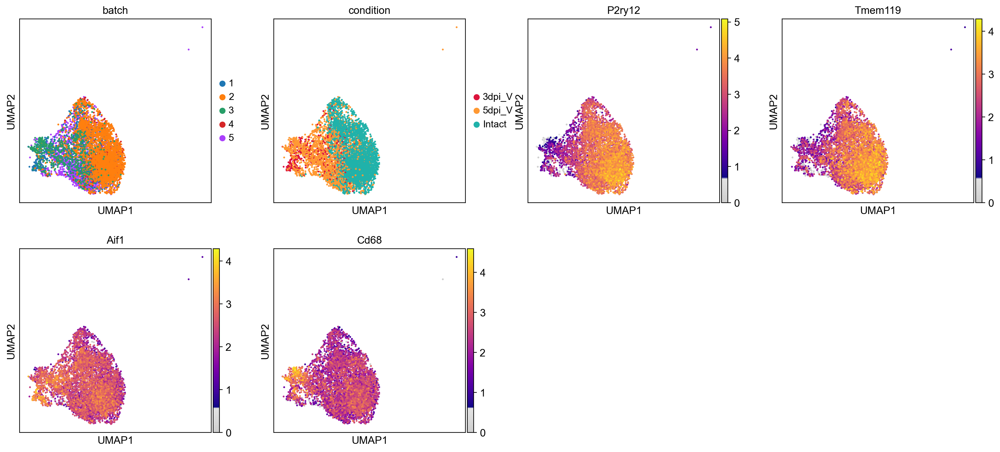

In [41]:
sc.pl.umap(adata_all_micro_proc, color=['batch', 'condition','P2ry12','Tmem119', 'Aif1', 'Cd68'], cmap=mymap2)

In [42]:
set(adata_all_micro_proc.obs['condition'])

{'3dpi_V', '5dpi_V', 'Intact'}

In [43]:
adata_all_micro_proc

AnnData object with n_obs × n_vars = 6824 × 13894
    obs: 'sample_id', 'sample_id_str', 'condition', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mt_frac', 'n_counts', 'n_genes', 'doublet_score', 'doublet', 'sample', 'experiment', 'size_factors', 'leiden', '_scvi_batch', '_scvi_labels', 'leiden_scVI', 'leiden_scVI2', 'leiden_scVI05', 'Microglia', 'DAM', 'BAM', 'Macrophages', 'Monocytes', 'DC', 'Neutrophils', 'B cells', 'T cells', 'gd T cells', 'Innate lymphoid cells (ILC) 2', 'NKT cells', 'NK cells', 'Neurons', 'OPCs', 'COPs', 'MOL', 'Astrocytes', 'Pericytes', 'VSMCs', 'VLMCs', 'VECV', 'S_score', 'G2M_score', 'phase', 'Cycling cells', 'G2M_phase', 'S_phase', 'annotated', 'clIX'
    var: 'gene_ids', 'feature_types', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'l

In [44]:
# use scVI latent space for UMAP generation
sc.pp.neighbors(adata_all_micro_proc, use_rep="X_scVI")

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)


In [45]:
sc.tl.umap(adata_all_micro_proc,)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:07)


In [46]:
sc.tl.leiden(adata_all_micro_proc, key_added='leiden_micro_r1')
sc.tl.leiden(adata_all_micro_proc, resolution=0.8, key_added='leiden_micro_r0.8')
sc.tl.leiden(adata_all_micro_proc, resolution=0.7, key_added='leiden_micro_r0.7')
sc.tl.leiden(adata_all_micro_proc, resolution=0.5, key_added='leiden_micro_r0.5')

running Leiden clustering
    finished: found 14 clusters and added
    'leiden_micro_r1', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 10 clusters and added
    'leiden_micro_r0.8', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 9 clusters and added
    'leiden_micro_r0.7', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 8 clusters and added
    'leiden_micro_r0.5', the cluster labels (adata.obs, categorical) (0:00:00)


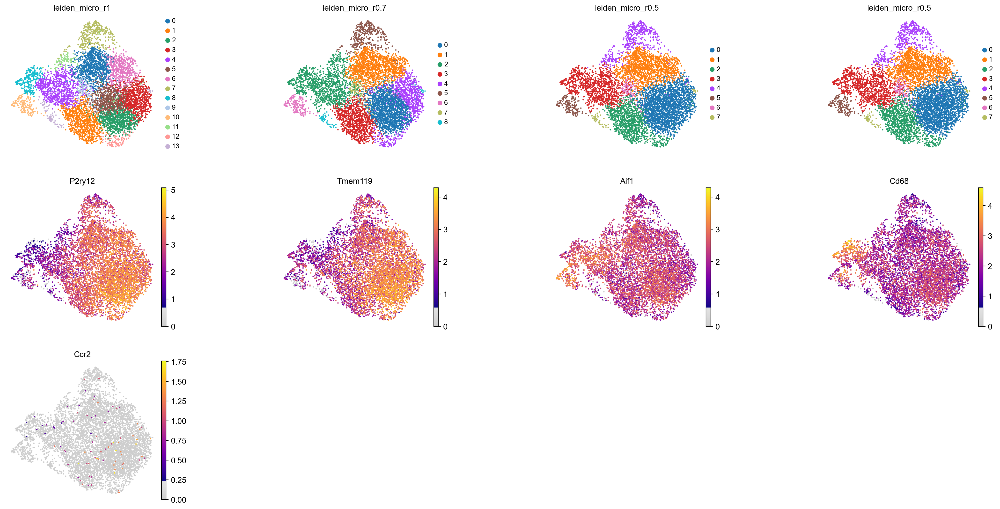

In [47]:
sc.pl.umap(adata_all_micro_proc, color=['leiden_micro_r1','leiden_micro_r0.7','leiden_micro_r0.5','leiden_micro_r0.5' ,
                                        'P2ry12','Tmem119', 'Aif1', 'Cd68','Ccr2'], legend_fontsize =float(10),
           wspace=0.6, legend_fontweight= 'normal', frameon= False,cmap=mymap2  )

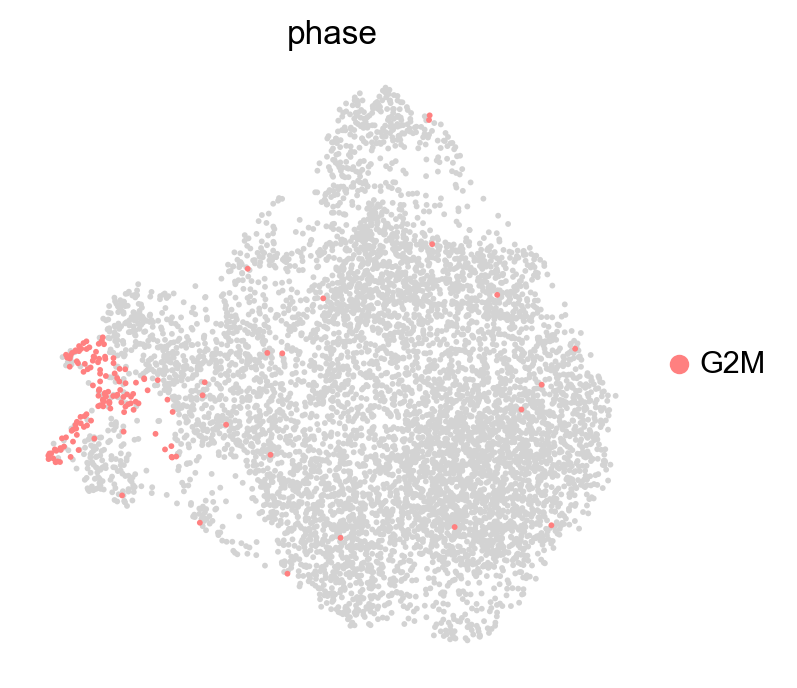

In [48]:
sc.pl.umap(adata_all_micro_proc, color=['phase'], groups=['G2M'], na_in_legend=False, cmap=mymap2, frameon= False, save='_micro_g2m_all.png')

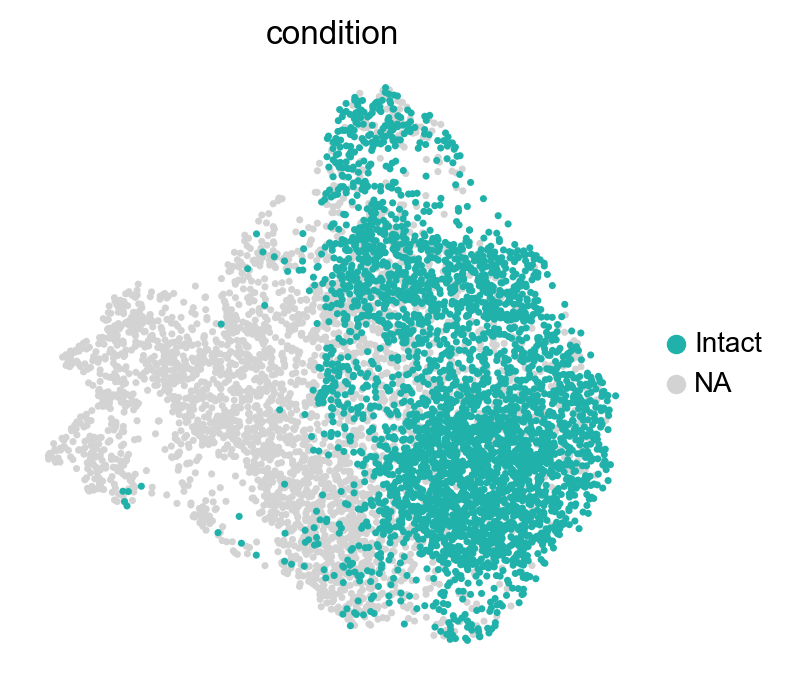

In [49]:
sc.pl.umap(adata_all_micro_proc, color=['condition'], legend_fontsize =float(10), legend_fontweight= 'normal',groups='Intact',size=26,  frameon= False )

In [50]:
print(adata_all_micro_proc.obs['condition'].value_counts())

Intact    3593
5dpi_V    2627
3dpi_V     604
Name: condition, dtype: int64


In [51]:
intact_subsam = sc.pp.subsample(adata_all_micro_proc[adata_all_micro_proc.obs['condition']=='Intact'],n_obs=604,copy=True).obs_names
five_dpi_V_subsam = sc.pp.subsample(adata_all_micro_proc[adata_all_micro_proc.obs['condition']=='5dpi_V'],n_obs=604,copy=True).obs_names
three_dpi_V_subsam = sc.pp.subsample(adata_all_micro_proc[adata_all_micro_proc.obs['condition']=='3dpi_V'],n_obs=604,copy=True).obs_names
adata_all_micro_proc_subsam = adata_all_micro_proc[list(intact_subsam) + list(five_dpi_V_subsam)+list(three_dpi_V_subsam)].copy()

In [52]:
sc.tl.embedding_density(adata_all_micro_proc_subsam, basis='umap', groupby='condition')

computing density on 'umap'
--> added
    'umap_density_condition', densities (adata.obs)
    'umap_density_condition_params', parameter (adata.uns)


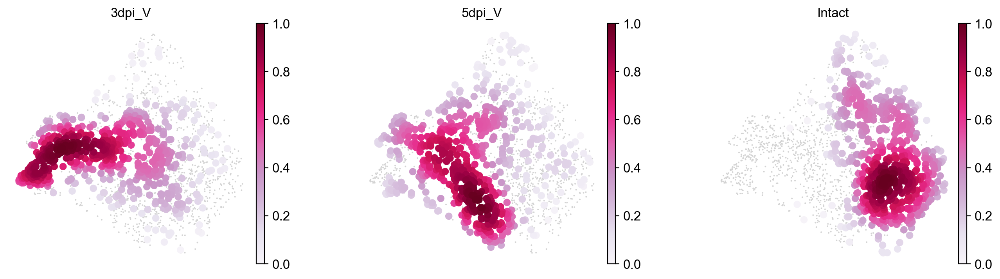

In [53]:
sc.pl.embedding_density(adata_all_micro_proc_subsam, basis='umap',  key='umap_density_condition', color_map='PuRd', wspace=0.3, bg_dotsize = 8, frameon= False, ncols=5,
                        save='_distribution_downscaling_ctr.png')

In [54]:
sc.tl.rank_genes_groups(adata_all_micro_proc, groupby='leiden_micro_r0.5', key_added='rank_genes_micro_r0.5', method='t-test_overestim_var', use_raw=True)

ranking genes
    finished: added to `.uns['rank_genes_micro_r0.5']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


    using 'X_pca' with n_pcs = 9
Storing dendrogram info using `.uns['dendrogram_leiden_micro_r0.5']`


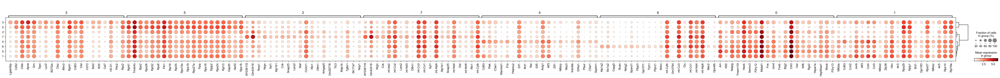

In [55]:
sc.pl.rank_genes_groups_dotplot(adata_all_micro_proc, n_genes=20, key='rank_genes_micro_r0.5',)

In [56]:
adata_all_micro_proc.write(data_dir+today + "adata_all_micro_proc_cl_scVI.h5ad")

# Plots figures

In [57]:
adata_all_micro_proc=sc.read(data_dir + "220713adata_all_micro_proc_cl_scVI.h5ad")

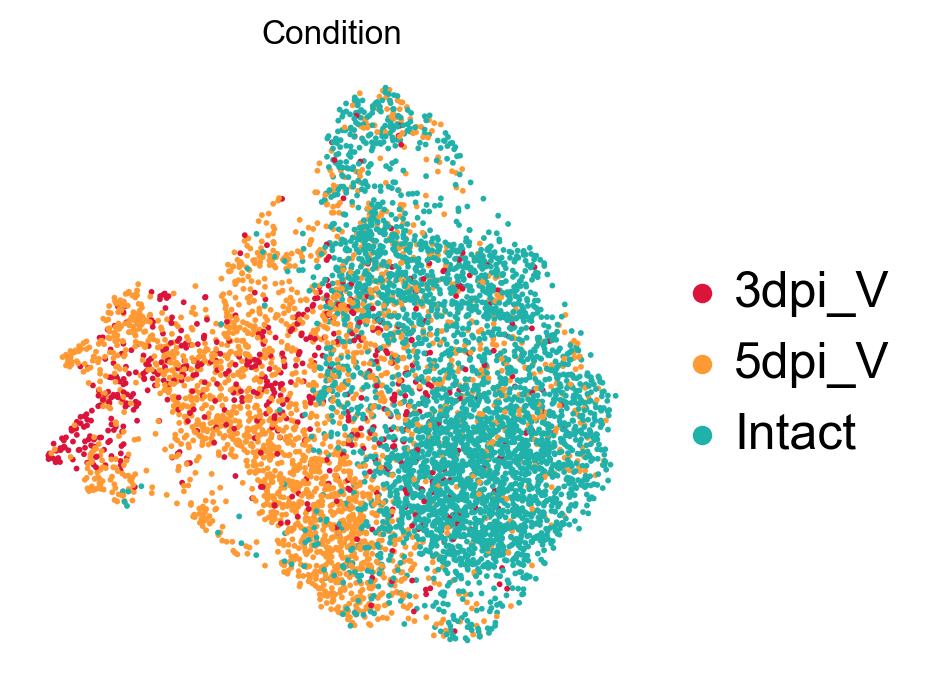

In [58]:
sc.pl.umap(adata_all_micro_proc, color=['condition'], legend_fontsize =float(18), legend_fontweight= 'normal', title= 'Condition',
           frameon= False,  save='_3M_condition.png')

In [59]:
clustersM= ['#4da6ff',
            '#b3d9ff',
            '#4169E1',
            '#ff6666',
            '#bdcbf5',
            '#ffb399',
            '#92a8d1',
            '#333399'
      ]

In [60]:
cluster2annotation = {
    '0': 'MG1',
    '1': 'MG2',
    '2': 'MG3',
    '3': 'MG4',
    '4': 'MG5',
    '5': 'MG6',
    '6': 'MG7',
    '7': 'MG8'
    }

In [61]:
adata_all_micro_proc.obs['clustersmicro'] = adata_all_micro_proc.obs['leiden_micro_r0.5'].map(cluster2annotation).astype('category')

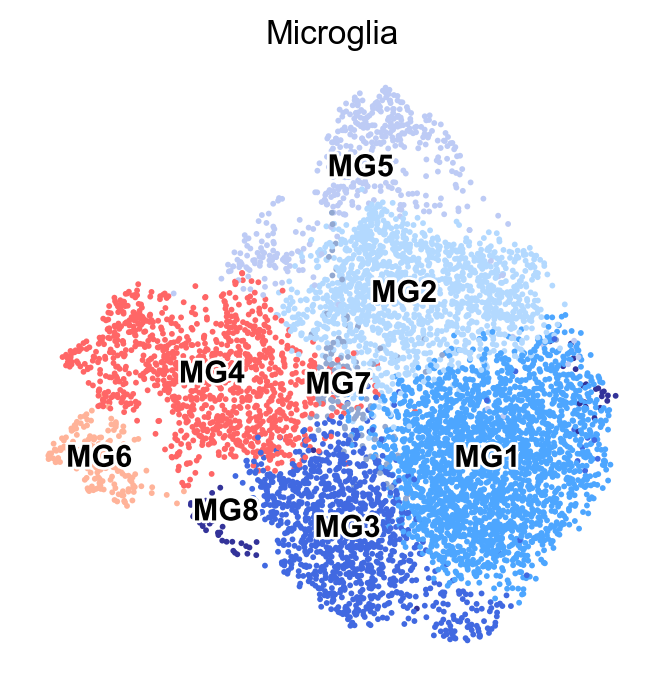

In [62]:
sc.pl.umap(adata_all_micro_proc, color=['clustersmicro'], title='Microglia',legend_fontoutline=2,legend_loc='on data',legend_fontsize =float(11),
           wspace=0.6, legend_fontweight= 'black', frameon= False,palette=clustersM, save='_1M_clusters.png'  )

In [63]:
print(adata_all_micro_proc.obs['condition'].value_counts())

Intact    3593
5dpi_V    2627
3dpi_V     604
Name: condition, dtype: int64


In [64]:
intact_subsam = sc.pp.subsample(adata_all_micro_proc[adata_all_micro_proc.obs['condition']=='Intact'],n_obs=604,copy=True).obs_names
five_dpi_V_subsam = sc.pp.subsample(adata_all_micro_proc[adata_all_micro_proc.obs['condition']=='5dpi_V'],n_obs=604,copy=True).obs_names
three_dpi_V_subsam = sc.pp.subsample(adata_all_micro_proc[adata_all_micro_proc.obs['condition']=='3dpi_V'],n_obs=604,copy=True).obs_names
adata_all_micro_proc_subsam = adata_all_micro_proc[list(intact_subsam) + list(five_dpi_V_subsam)+list(three_dpi_V_subsam)].copy()

In [65]:
sc.tl.embedding_density(adata_all_micro_proc_subsam, basis='umap', groupby='condition')

computing density on 'umap'
--> added
    'umap_density_condition', densities (adata.obs)
    'umap_density_condition_params', parameter (adata.uns)


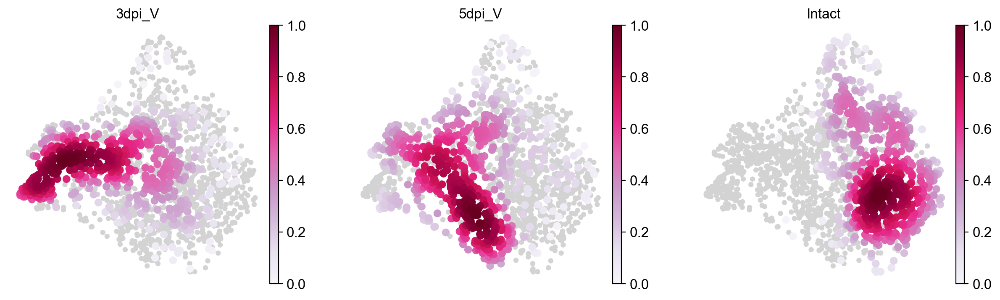

In [66]:
sc.pl.embedding_density(adata_all_micro_proc_subsam, basis='umap',  key='umap_density_condition', color_map='PuRd', 
                        frameon= False, ncols=5, save='_distribution_downscaling_micro.png')

In [67]:
sc.tl.rank_genes_groups(adata_all_micro_proc, groupby='clustersmicro', key_added='rank_genes_clustersmicro', 
                        method='t-test_overestim_var', use_raw=True)

ranking genes
    finished: added to `.uns['rank_genes_clustersmicro']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


    using 'X_pca' with n_pcs = 9
Storing dendrogram info using `.uns['dendrogram_clustersmicro']`


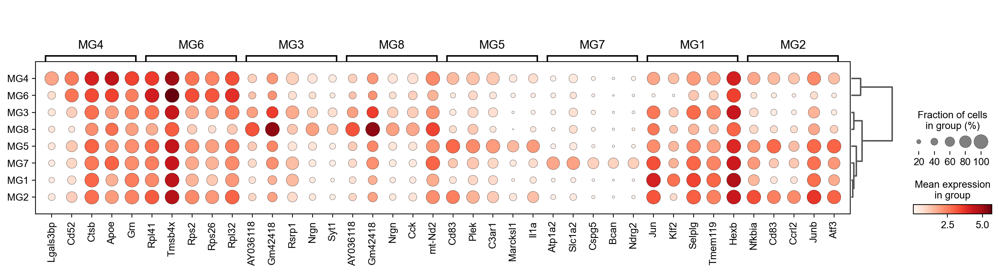

In [68]:
sc.pl.rank_genes_groups_dotplot(adata_all_micro_proc, n_genes=5, key='rank_genes_clustersmicro', cmap='Reds', save='rank_micro.png')

In [69]:
result = adata_all_micro_proc.uns['rank_genes_clustersmicro']
groups = result['names'].dtype.names
adata_aclmicro_genes = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names','scores', 'pvals','logfoldchanges']})

In [70]:
adata_aclmicro_genes

,MG1_n,MG1_s,MG1_p,MG1_l,MG2_n,MG2_s,MG2_p,MG2_l,MG3_n,MG3_s,...,MG6_p,MG6_l,MG7_n,MG7_s,MG7_p,MG7_l,MG8_n,MG8_s,MG8_p,MG8_l
0,Jun,50.696720,0.000000e+00,2.355125,Nfkbia,44.607872,0.000000e+00,2.957179,AY036118,19.113024,...,4.253545e-55,2.084453,Atp1a2,17.182770,2.048863e-42,4.089100,AY036118,12.356737,3.094872e-23,3.679775
1,Klf2,42.080597,0.000000e+00,2.813548,Cd83,38.925129,1.786497e-266,2.801427,Gm42418,18.139139,...,8.180473e-59,1.592343,Slc1a2,14.410603,9.960674e-35,3.191177,Gm42418,11.415833,5.205838e-19,4.603953
2,Selplg,41.576706,5.726192e-310,1.334242,Ccrl2,38.759319,7.381801e-265,2.832605,Rsrp1,17.825680,...,1.420396e-49,2.090549,Cspg5,12.561782,1.756801e-27,3.442052,Nrgn,10.109656,2.441992e-18,2.863666
3,Tmem119,37.896912,5.109671e-268,1.256799,Junb,35.471947,2.948855e-222,2.015832,Nrgn,16.645075,...,6.781870e-47,2.261972,Bcan,12.555643,1.951412e-26,4.187954,Cck,8.613500,1.358640e-14,2.365495
4,Hexb,37.015633,2.496658e-259,0.804270,Atf3,34.464855,1.438603e-216,2.469213,Syt1,16.086401,...,6.217457e-46,1.891762,Ndrg2,12.518394,3.997555e-27,3.581051,mt-Nd2,8.196556,1.585425e-13,2.163625
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19285,Rps26,-35.450508,2.550106e-244,-1.546476,Ctsb,-12.779481,2.693592e-36,-0.510531,Junb,-26.018497,...,4.285057e-61,-4.415962,Ly86,-4.316453,2.197286e-05,-0.587781,Tyrobp,-12.200483,1.477744e-21,-2.813349
19286,Rps12,-36.117748,1.787976e-252,-1.371683,Ctsz,-13.081818,5.278106e-38,-0.470340,H3f3b,-26.464390,...,2.290049e-65,-3.612108,Ctsl,-4.381500,1.694924e-05,-0.562863,Rpl23a,-12.576972,3.683811e-24,-3.829885
19287,Rpl23,-36.255493,3.216606e-254,-1.190656,Mafb,-16.858694,8.318705e-61,-1.114681,Ubc,-27.483681,...,6.778681e-70,-3.503970,C1qa,-4.462304,1.174116e-05,-0.337660,B2m,-12.592533,4.172298e-24,-3.181996
19288,Rpl32,-37.240200,1.870274e-266,-1.273237,Rsrp1,-17.192511,4.162805e-63,-1.098039,Ftl1,-30.774734,...,8.105881e-74,-6.360774,Ctsz,-4.819451,2.419556e-06,-0.531646,Fcer1g,-12.728781,4.235606e-23,-3.077101


In [71]:
adata_aclmicro_genes.to_csv(table_dir+today+'adata_aclmicro_genes.csv')

# Oligodendrocytes

In [72]:
adata_all_oligos_proc=sc.read(data_dir + "220713adata_ctr_oligos_proc_scVI.h5ad")

In [73]:
#Filter genes:
print('Total number of genes: {:d}'.format(adata_all_oligos_proc.n_vars))

# Min 20 cells - filters out 0 count genes
sc.pp.filter_genes(adata_all_oligos_proc, min_cells=20)
print('Number of genes after cell filter: {:d}'.format(adata_all_oligos_proc.n_vars))

Total number of genes: 19290
filtered out 5959 genes that are detected in less than 20 cells
Number of genes after cell filter: 13331


In [74]:
sc.tl.umap(adata_all_oligos_proc,spread=0.5)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:03)


In [75]:
sc.tl.leiden(adata_all_oligos_proc, key_added='leiden_oligos_r1')
sc.tl.leiden(adata_all_oligos_proc, resolution=0.6, key_added='leiden_oligos_r0.5')
sc.tl.leiden(adata_all_oligos_proc, resolution=0.3, key_added='leiden_oligos_r0.3')

running Leiden clustering
    finished: found 16 clusters and added
    'leiden_oligos_r1', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 11 clusters and added
    'leiden_oligos_r0.5', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 8 clusters and added
    'leiden_oligos_r0.3', the cluster labels (adata.obs, categorical) (0:00:00)


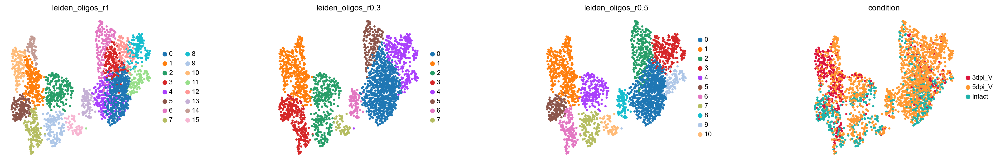

In [76]:
sc.pl.umap(adata_all_oligos_proc, color=['leiden_oligos_r1','leiden_oligos_r0.3','leiden_oligos_r0.5' ,'condition'], legend_fontsize =float(10),
           wspace=0.6, legend_fontweight= 'normal', frameon= False,cmap=mymap2  )

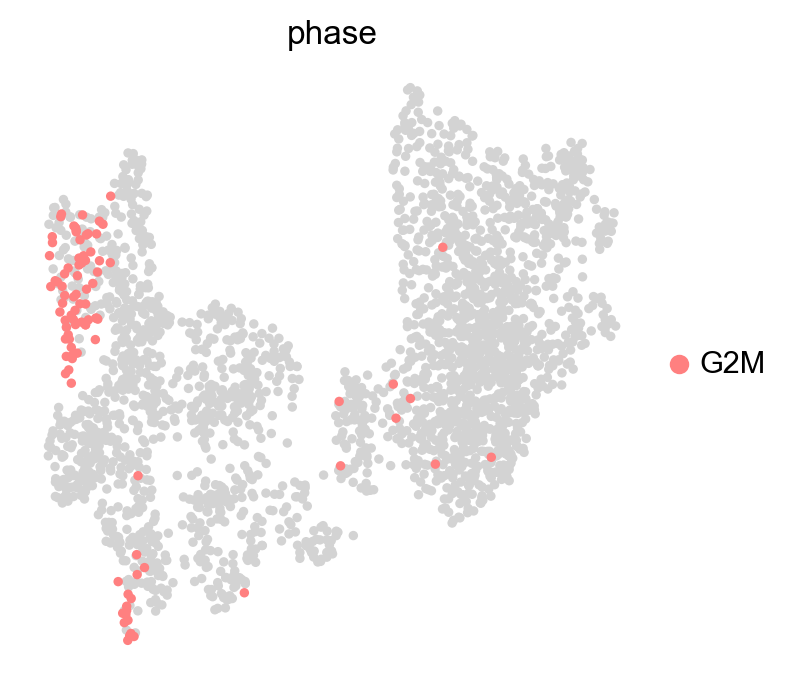

In [77]:
sc.pl.umap(adata_all_oligos_proc, color=['phase'], groups=['G2M'], na_in_legend=False, cmap=mymap2, frameon= False )#, save='_oligos_g2m_all.png')

In [78]:
sc.tl.rank_genes_groups(adata_all_oligos_proc, groupby='leiden_oligos_r0.5', key_added='rank_genes_oligos_r0.5', method='t-test_overestim_var', use_raw=True)

ranking genes
    finished: added to `.uns['rank_genes_oligos_r0.5']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


    using 'X_pca' with n_pcs = 9
Storing dendrogram info using `.uns['dendrogram_leiden_oligos_r0.5']`


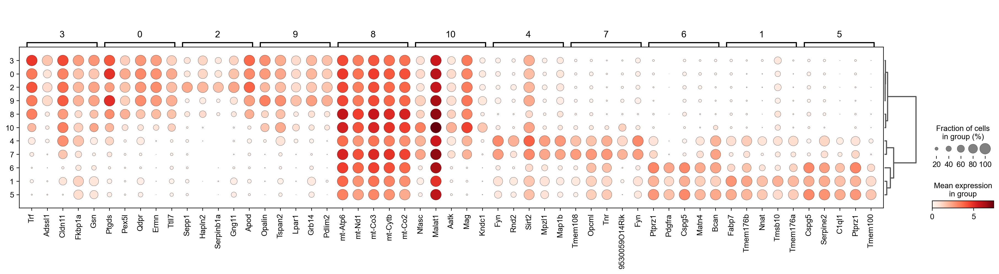

In [79]:
sc.pl.rank_genes_groups_dotplot(adata_all_oligos_proc, n_genes=5, key='rank_genes_oligos_r0.5', )

In [80]:
adata_all_oligos_proc.write(data_dir+today + "adata_all_oligos_proc_cl_scVI.h5ad")

# Plots figures

In [81]:
adata_all_oligos_proc=sc.read(data_dir + "220713adata_all_oligos_proc_cl_scVI.h5ad")

In [82]:
OPCs=('Pdgfra', 'C1ql1','Sapcd2','Emid1')
COPs=('Neu4', 'Brca1', 'Gpr17', 'Pak4','Lims2')
NFOL=('Cnksr3', 'H2-Ab1','Cnksr3','Rras2','Tmem2','Il23a','Tmem163')
MFOL=('2210011C24Rik', 'Wfdc18', 'Tmem141','Opalin','Birc2','Fam214a')
MOL=('Opalin', 'Ninj2',)

In [83]:
sc.tl.score_genes(adata_all_oligos_proc, OPCs, score_name='OPCs' )
sc.tl.score_genes(adata_all_oligos_proc, COPs, score_name='COPs' )
sc.tl.score_genes(adata_all_oligos_proc, NFOL, score_name='NFOL' )
sc.tl.score_genes(adata_all_oligos_proc, MFOL, score_name='MFOL' )
sc.tl.score_genes(adata_all_oligos_proc, MOL, score_name='MOL' )

computing score 'OPCs'
    finished: added
    'OPCs', score of gene set (adata.obs).
    200 total control genes are used. (0:00:00)
computing score 'COPs'
    finished: added
    'COPs', score of gene set (adata.obs).
    200 total control genes are used. (0:00:00)
computing score 'NFOL'
    finished: added
    'NFOL', score of gene set (adata.obs).
    200 total control genes are used. (0:00:00)
computing score 'MFOL'
    finished: added
    'MFOL', score of gene set (adata.obs).
    300 total control genes are used. (0:00:00)
computing score 'MOL'
    finished: added
    'MOL', score of gene set (adata.obs).
    100 total control genes are used. (0:00:00)


In [84]:
adata_all_oligos_proc

AnnData object with n_obs × n_vars = 2596 × 13331
    obs: 'sample_id', 'sample_id_str', 'condition', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mt_frac', 'n_counts', 'n_genes', 'doublet_score', 'doublet', 'sample', 'experiment', 'size_factors', 'leiden', '_scvi_batch', '_scvi_labels', 'leiden_scVI', 'leiden_scVI2', 'leiden_scVI05', 'Microglia', 'DAM', 'BAM', 'Macrophages', 'Monocytes', 'DC', 'Neutrophils', 'B cells', 'T cells', 'gd T cells', 'Innate lymphoid cells (ILC) 2', 'NKT cells', 'NK cells', 'Neurons', 'OPCs', 'COPs', 'MOL', 'Astrocytes', 'Pericytes', 'VSMCs', 'VLMCs', 'VECV', 'S_score', 'G2M_score', 'phase', 'Cycling cells', 'G2M_phase', 'S_phase', 'annotated', 'clIX', 'leiden_oligos_r1', 'leiden_oligos_r0.5', 'leiden_oligos_r0.6', 'NFOL', 'MFOL'
    var: 'gene_ids', 'feature_types', 'n_cells_by_counts',

In [85]:
cluster2annotation = {
    '0': 'MOL1',
    '1': 'OPCs2',
    '2': 'MOL2',
    '3': 'OPCs1',
    '4': 'MOL3',
    '5': 'COPs1',
    '6': 'COPs2',
    '7': 'MOL4',
    '8': 'MOL5',
    '9': 'MFOL',
    }

In [86]:
adata_all_oligos_proc.obs['clustersoligos'] = adata_all_oligos_proc.obs['leiden_oligos_r0.5'].map(cluster2annotation).astype('category')

In [87]:
clustersO= [ '#b3b3ff',#'0': 'MOL1',
    '#ff6666',#'1': 'OPCs2',
    '#6666ff',#2': 'MOL2',
    '#4169E1',#'3': 'OPCs1',
    '#5d7ebb',#'4': 'MOL3',
    '#bdcbf5',#'5': 'COPs1',
    '#92a8d1',#'6': 'COPs2',
    '#BA55D3',#'7': 'MOL4',
     '#c299ff',#'8': 'MOL5',
    '#b3d9ff'#'9': 'MFOL',
]

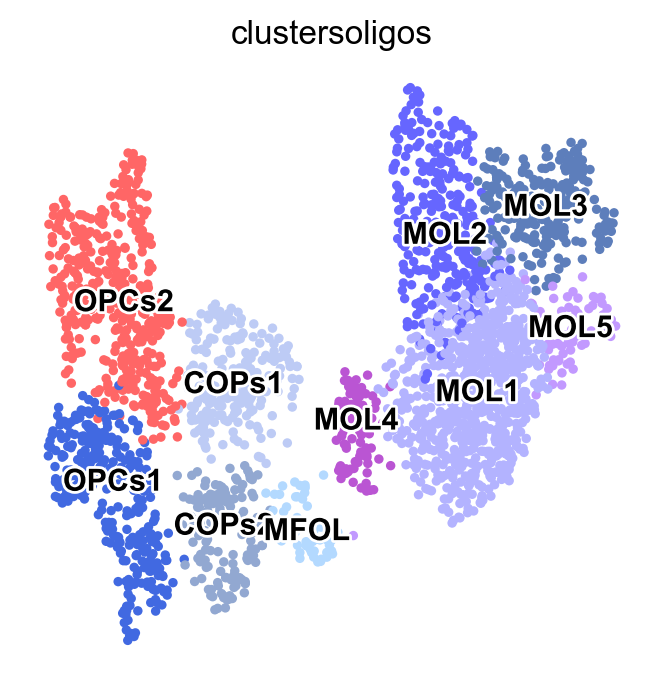

In [88]:
sc.pl.umap(adata_all_oligos_proc, color=['clustersoligos'],legend_fontoutline=2,legend_loc='on data',legend_fontsize =float(11),
           wspace=0.6, legend_fontweight= 'black', frameon= False,palette=clustersO, save='_1M_clusters.png'  )

In [89]:
print(adata_all_oligos_proc.obs['condition'].value_counts())

5dpi_V    1614
Intact     552
3dpi_V     430
Name: condition, dtype: int64


In [90]:
intact_subsam = sc.pp.subsample(adata_all_oligos_proc[adata_all_oligos_proc.obs['condition']=='Intact'],n_obs=430,copy=True).obs_names
five_dpi_V_subsam = sc.pp.subsample(adata_all_oligos_proc[adata_all_oligos_proc.obs['condition']=='5dpi_V'],n_obs=430,copy=True).obs_names
three_dpi_V_subsam = sc.pp.subsample(adata_all_oligos_proc[adata_all_oligos_proc.obs['condition']=='3dpi_V'],n_obs=430,copy=True).obs_names
adata_all_oligos_proc_subsam = adata_all_oligos_proc[list(intact_subsam) + list(five_dpi_V_subsam)+list(three_dpi_V_subsam)].copy()

In [91]:
sc.tl.embedding_density(adata_all_oligos_proc_subsam, basis='umap', groupby='condition')

computing density on 'umap'
--> added
    'umap_density_condition', densities (adata.obs)
    'umap_density_condition_params', parameter (adata.uns)


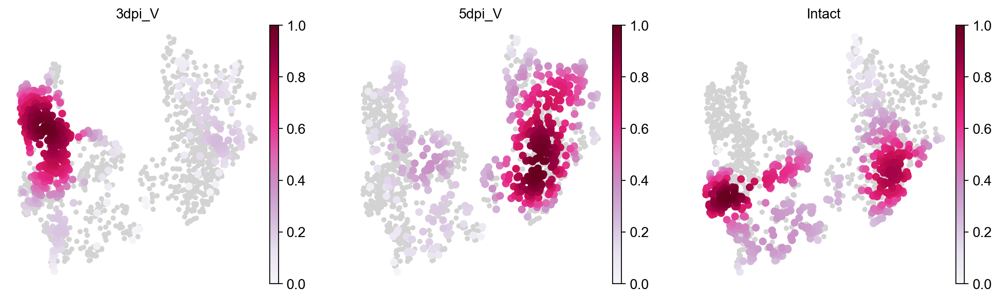

In [92]:
sc.pl.embedding_density(adata_all_oligos_proc_subsam, basis='umap',  key='umap_density_condition', color_map='PuRd',  frameon= False, ncols=5, save='_distribution_downscaling_oligos.png')

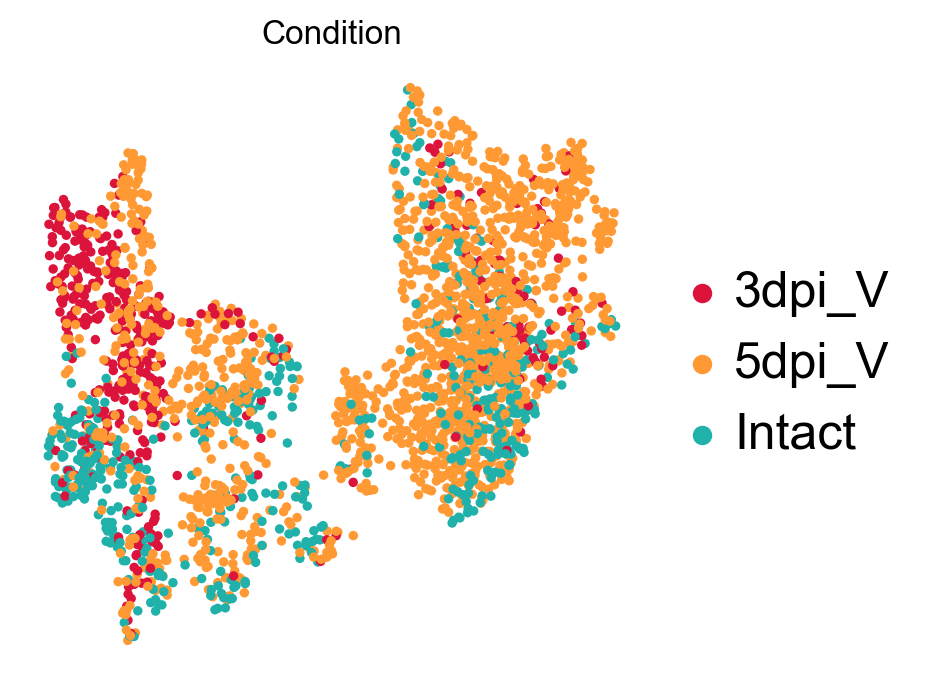

In [93]:
sc.pl.umap(adata_all_oligos_proc, color=['condition'], legend_fontsize =float(18), legend_fontweight= 'normal', title= 'Condition', frameon= False,  save='_3o_condition_all.png' )

In [94]:
sc.tl.rank_genes_groups(adata_all_oligos_proc, groupby='clustersoligos', key_added='rank_genes_clustersoligos', method='t-test_overestim_var', use_raw=True)

ranking genes
    finished: added to `.uns['rank_genes_clustersoligos']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


    using 'X_pca' with n_pcs = 9
Storing dendrogram info using `.uns['dendrogram_clustersoligos']`


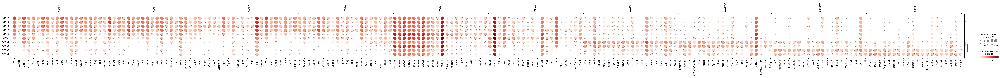

In [95]:
sc.pl.rank_genes_groups_dotplot(adata_all_oligos_proc, n_genes=20, key='rank_genes_clustersoligos')

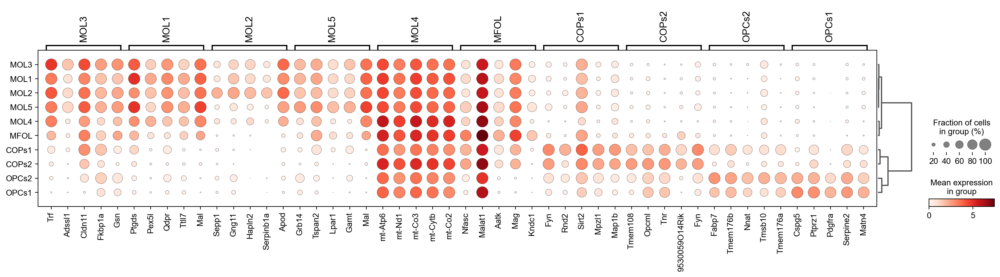

In [96]:
sc.pl.rank_genes_groups_dotplot(adata_all_oligos_proc, n_genes=5, key='rank_genes_clustersoligos', cmap='Reds', save='rank_oligos.png')

In [97]:
result = adata_all_oligos_proc.uns['rank_genes_clustersoligos']
groups = result['names'].dtype.names
adata_cloligos_genes = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names','scores', 'pvals','logfoldchanges']})

In [98]:
adata_cloligos_genes

,MOL1_n,MOL1_s,MOL1_p,MOL1_l,OPCs2_n,OPCs2_s,OPCs2_p,OPCs2_l,MOL2_n,MOL2_s,...,MOL4_p,MOL4_l,MOL5_n,MOL5_s,MOL5_p,MOL5_l,MFOL_n,MFOL_s,MFOL_p,MFOL_l
0,Ptgds,43.727154,4.189606e-236,5.019905,Fabp7,42.498730,3.915392e-211,4.719144,Sepp1,26.843142,...,3.178821e-34,2.136031,Grb14,11.760568,4.582308e-20,2.454917,Nfasc,12.280070,5.466718e-22,3.859373
1,Pex5l,39.351036,2.917025e-224,3.146910,Tmem176b,37.556934,8.647356e-176,3.995988,Gng11,26.076399,...,1.382382e-33,2.010494,Tspan2,11.547063,1.850107e-19,2.553837,Malat1,10.448951,7.595075e-18,2.342686
2,Qdpr,37.630451,1.008253e-189,3.062843,Nnat,35.678997,1.979524e-170,3.927505,Hapln2,25.448380,...,1.347426e-32,2.181065,Lpar1,11.428936,2.527236e-21,2.517645,Aatk,10.052851,4.994877e-17,2.878318
3,Ttll7,36.410542,1.784225e-201,2.868766,Tmsb10,34.970917,7.612343e-166,3.294037,Serpinb1a,24.326796,...,4.281571e-32,2.033034,Gamt,11.250713,3.479997e-21,2.586959,Mag,9.945201,2.610526e-16,3.620404
4,Mal,35.680603,1.586636e-171,3.795481,Tmem176a,33.501007,6.371232e-157,3.798189,Apod,22.060501,...,3.256126e-32,2.442694,Mal,11.030349,9.841331e-18,3.678751,Kndc1,9.613619,3.505370e-15,3.489919
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19285,Bcan,-24.480158,6.352338e-101,-4.181590,Plp1,-32.942928,1.985922e-145,-5.399755,Serpine2,-13.861581,...,1.026341e-15,-1.537434,Serpine2,-6.218043,2.336038e-08,-4.281499,Btf3,-9.438615,1.288080e-15,-3.261365
19286,Serpine2,-24.816380,3.082111e-102,-4.440395,Sept4,-33.140724,1.621799e-124,-5.814492,Tmem176b,-13.873408,...,5.353401e-16,-2.291666,Bcan,-6.565356,5.488818e-09,-5.076895,Dbi,-9.475358,9.932237e-16,-3.156145
19287,S100b,-25.181023,1.863026e-109,-3.240255,Aplp1,-34.693932,2.123466e-142,-4.018393,Bcan,-14.166275,...,1.048214e-15,-2.992300,Marcks,-6.681601,3.555111e-09,-4.805697,H3f3a,-9.684246,2.942023e-16,-2.947166
19288,Tmem176b,-25.576374,1.963092e-105,-5.833356,Mag,-39.310516,1.508727e-149,-7.247383,Cd9,-14.462365,...,7.005780e-17,-2.222787,Rtn1,-6.685573,8.711498e-10,-1.900020,Eef1a1,-10.947505,6.101572e-19,-2.908318


In [99]:
adata_cloligos_genes.to_csv(table_dir+today+'adata_cloligos_genes.csv')

# save genes for clusters

In [100]:
set(adata_all_astros_proc.obs['clustersastros'])

{'AG1', 'AG2', 'AG3', 'AG4', 'AG5', 'AG6', 'AG7', 'AG8', 'AG9'}

In [101]:
MOL1 =sc.get.rank_genes_groups_df(adata_all_oligos_proc, group='MOL1', key='rank_genes_clustersoligos', pval_cutoff=0.05, log2fc_min=1.6)
MOL2 =sc.get.rank_genes_groups_df(adata_all_oligos_proc, group='MOL2', key='rank_genes_clustersoligos', pval_cutoff=0.05, log2fc_min=1.6)
MOL3 =sc.get.rank_genes_groups_df(adata_all_oligos_proc, group='MOL3', key='rank_genes_clustersoligos', pval_cutoff=0.05, log2fc_min=1.6)
MOL4 =sc.get.rank_genes_groups_df(adata_all_oligos_proc, group='MOL4', key='rank_genes_clustersoligos', pval_cutoff=0.05, log2fc_min=1.6)
MOL5 =sc.get.rank_genes_groups_df(adata_all_oligos_proc, group='MOL5', key='rank_genes_clustersoligos', pval_cutoff=0.05, log2fc_min=1.6)
OPCs1=sc.get.rank_genes_groups_df(adata_all_oligos_proc, group='OPCs1', key='rank_genes_clustersoligos', pval_cutoff=0.05, log2fc_min=1.6)
OPCs2=sc.get.rank_genes_groups_df(adata_all_oligos_proc, group='OPCs2', key='rank_genes_clustersoligos', pval_cutoff=0.05, log2fc_min=1.6)
COPs1=sc.get.rank_genes_groups_df(adata_all_oligos_proc, group='COPs1', key='rank_genes_clustersoligos', pval_cutoff=0.05, log2fc_min=1.6)
COPs2=sc.get.rank_genes_groups_df(adata_all_oligos_proc, group='COPs2', key='rank_genes_clustersoligos', pval_cutoff=0.05, log2fc_min=1.6)
MFOL =sc.get.rank_genes_groups_df(adata_all_oligos_proc, group='MFOL', key='rank_genes_clustersoligos', pval_cutoff=0.05, log2fc_min=1.6)
AG1  =sc.get.rank_genes_groups_df(adata_all_astros_proc, group='AG1', key='rank_genes_astros_clustersastros', pval_cutoff=0.05, log2fc_min=1.6)
AG2  =sc.get.rank_genes_groups_df(adata_all_astros_proc, group='AG2', key='rank_genes_astros_clustersastros', pval_cutoff=0.05, log2fc_min=1.6)
AG3  =sc.get.rank_genes_groups_df(adata_all_astros_proc, group='AG3', key='rank_genes_astros_clustersastros', pval_cutoff=0.05, log2fc_min=1.6)
AG4  =sc.get.rank_genes_groups_df(adata_all_astros_proc, group='AG4', key='rank_genes_astros_clustersastros', pval_cutoff=0.05, log2fc_min=1.6)
AG5  =sc.get.rank_genes_groups_df(adata_all_astros_proc, group='AG5', key='rank_genes_astros_clustersastros', pval_cutoff=0.05, log2fc_min=1.6)
AG6  =sc.get.rank_genes_groups_df(adata_all_astros_proc, group='AG6', key='rank_genes_astros_clustersastros', pval_cutoff=0.05, log2fc_min=1.6)
AG7  =sc.get.rank_genes_groups_df(adata_all_astros_proc, group='AG7', key='rank_genes_astros_clustersastros', pval_cutoff=0.05, log2fc_min=1.6)
AG8  =sc.get.rank_genes_groups_df(adata_all_astros_proc, group='AG8', key='rank_genes_astros_clustersastros', pval_cutoff=0.05, log2fc_min=1.6)
AG9  =sc.get.rank_genes_groups_df(adata_all_astros_proc, group='AG9', key='rank_genes_astros_clustersastros', pval_cutoff=0.05, log2fc_min=1.6)
MG1  =sc.get.rank_genes_groups_df(adata_all_micro_proc, group='MG1', key='rank_genes_clustersmicro', pval_cutoff=0.05, log2fc_min=1.6)
MG2  =sc.get.rank_genes_groups_df(adata_all_micro_proc, group='MG2', key='rank_genes_clustersmicro', pval_cutoff=0.05, log2fc_min=1.6)  
MG3  =sc.get.rank_genes_groups_df(adata_all_micro_proc, group='MG3', key='rank_genes_clustersmicro', pval_cutoff=0.05, log2fc_min=1.6)
MG4  =sc.get.rank_genes_groups_df(adata_all_micro_proc, group='MG4', key='rank_genes_clustersmicro', pval_cutoff=0.05, log2fc_min=1.6)
MG5  =sc.get.rank_genes_groups_df(adata_all_micro_proc, group='MG5', key='rank_genes_clustersmicro', pval_cutoff=0.05, log2fc_min=1.6)
MG6  =sc.get.rank_genes_groups_df(adata_all_micro_proc, group='MG6', key='rank_genes_clustersmicro', pval_cutoff=0.05, log2fc_min=1.6)
MG7  =sc.get.rank_genes_groups_df(adata_all_micro_proc, group='MG7', key='rank_genes_clustersmicro', pval_cutoff=0.05, log2fc_min=1.6)
MG8  =sc.get.rank_genes_groups_df(adata_all_micro_proc, group='MG8', key='rank_genes_clustersmicro', pval_cutoff=0.05, log2fc_min=1.6)

In [102]:
d_MOL1 =sc.get.rank_genes_groups_df(adata_all_oligos_proc, group='MOL1', key='rank_genes_clustersoligos', pval_cutoff=0.05, log2fc_max=-1.6)
d_MOL2 =sc.get.rank_genes_groups_df(adata_all_oligos_proc, group='MOL2', key='rank_genes_clustersoligos', pval_cutoff=0.05, log2fc_max=-1.6)
d_MOL3 =sc.get.rank_genes_groups_df(adata_all_oligos_proc, group='MOL3', key='rank_genes_clustersoligos', pval_cutoff=0.05, log2fc_max=-1.6)
d_MOL4 =sc.get.rank_genes_groups_df(adata_all_oligos_proc, group='MOL4', key='rank_genes_clustersoligos', pval_cutoff=0.05, log2fc_max=-1.6)
d_MOL5 =sc.get.rank_genes_groups_df(adata_all_oligos_proc, group='MOL5', key='rank_genes_clustersoligos', pval_cutoff=0.05, log2fc_max=-1.6)
d_OPCs1=sc.get.rank_genes_groups_df(adata_all_oligos_proc, group='OPCs1', key='rank_genes_clustersoligos', pval_cutoff=0.05, log2fc_max=-1.6)
d_OPCs2=sc.get.rank_genes_groups_df(adata_all_oligos_proc, group='OPCs2', key='rank_genes_clustersoligos', pval_cutoff=0.05, log2fc_max=-1.6)
d_COPs1=sc.get.rank_genes_groups_df(adata_all_oligos_proc, group='COPs1', key='rank_genes_clustersoligos', pval_cutoff=0.05, log2fc_max=-1.6)
d_COPs2=sc.get.rank_genes_groups_df(adata_all_oligos_proc, group='COPs2', key='rank_genes_clustersoligos', pval_cutoff=0.05, log2fc_max=-1.6)
d_MFOL =sc.get.rank_genes_groups_df(adata_all_oligos_proc, group='MFOL', key='rank_genes_clustersoligos', pval_cutoff=0.05, log2fc_max=-1.6)
d_AG1  =sc.get.rank_genes_groups_df(adata_all_astros_proc, group='AG1', key='rank_genes_astros_clustersastros', pval_cutoff=0.05, log2fc_max=-1.6)
d_AG2  =sc.get.rank_genes_groups_df(adata_all_astros_proc, group='AG2', key='rank_genes_astros_clustersastros', pval_cutoff=0.05, log2fc_max=-1.6)
d_AG3  =sc.get.rank_genes_groups_df(adata_all_astros_proc, group='AG3', key='rank_genes_astros_clustersastros', pval_cutoff=0.05, log2fc_max=-1.6)
d_AG4  =sc.get.rank_genes_groups_df(adata_all_astros_proc, group='AG4', key='rank_genes_astros_clustersastros', pval_cutoff=0.05, log2fc_max=-1.6)
d_AG5  =sc.get.rank_genes_groups_df(adata_all_astros_proc, group='AG5', key='rank_genes_astros_clustersastros', pval_cutoff=0.05, log2fc_max=-1.6)
d_AG6  =sc.get.rank_genes_groups_df(adata_all_astros_proc, group='AG6', key='rank_genes_astros_clustersastros', pval_cutoff=0.05, log2fc_max=-1.6)
d_AG7  =sc.get.rank_genes_groups_df(adata_all_astros_proc, group='AG7', key='rank_genes_astros_clustersastros', pval_cutoff=0.05, log2fc_max=-1.6)
d_AG8  =sc.get.rank_genes_groups_df(adata_all_astros_proc, group='AG8', key='rank_genes_astros_clustersastros', pval_cutoff=0.05, log2fc_max=-1.6)
d_AG9  =sc.get.rank_genes_groups_df(adata_all_astros_proc, group='AG9', key='rank_genes_astros_clustersastros', pval_cutoff=0.05, log2fc_max=-1.6)
d_MG1  =sc.get.rank_genes_groups_df(adata_all_micro_proc, group='MG1', key='rank_genes_clustersmicro', pval_cutoff=0.05, log2fc_max=-1.6)
d_MG2  =sc.get.rank_genes_groups_df(adata_all_micro_proc, group='MG2', key='rank_genes_clustersmicro', pval_cutoff=0.05, log2fc_max=-1.6)  
d_MG3  =sc.get.rank_genes_groups_df(adata_all_micro_proc, group='MG3', key='rank_genes_clustersmicro', pval_cutoff=0.05, log2fc_max=-1.6)
d_MG4  =sc.get.rank_genes_groups_df(adata_all_micro_proc, group='MG4', key='rank_genes_clustersmicro', pval_cutoff=0.05, log2fc_max=-1.6)
d_MG5  =sc.get.rank_genes_groups_df(adata_all_micro_proc, group='MG5', key='rank_genes_clustersmicro', pval_cutoff=0.05, log2fc_max=-1.6)
d_MG6  =sc.get.rank_genes_groups_df(adata_all_micro_proc, group='MG6', key='rank_genes_clustersmicro', pval_cutoff=0.05, log2fc_max=-1.6)
d_MG7  =sc.get.rank_genes_groups_df(adata_all_micro_proc, group='MG7', key='rank_genes_clustersmicro', pval_cutoff=0.05, log2fc_max=-1.6)
d_MG8  =sc.get.rank_genes_groups_df(adata_all_micro_proc, group='MG8', key='rank_genes_clustersmicro', pval_cutoff=0.05, log2fc_max=-1.6)

In [103]:
clusters_enriched_genes = {
'MOL1': pd.Series(MOL1['names']),
'MOL2': pd.Series(MOL2['names']),
'MOL3': pd.Series(MOL3['names']),
'MOL4': pd.Series(MOL4['names']),
'MOL5': pd.Series(MOL5['names']),
'OPCs1': pd.Series(OPCs1['names']),
'OPCs2': pd.Series(OPCs2['names']),
'COPs1': pd.Series(COPs1['names']),
'COPs2': pd.Series(COPs2['names']),
'MFOL':  pd.Series(MFOL['names']),
'AG1':   pd.Series(AG1['names']),
'AG2':   pd.Series(AG2['names']),   
'AG3':   pd.Series(AG3['names']),  
'AG4':   pd.Series(AG4['names']),  
'AG5':   pd.Series(AG5['names']), 
'AG6':   pd.Series(AG6['names']),  
'AG7':   pd.Series(AG7['names']),  
'AG8':   pd.Series(AG8['names']), 
'AG9':   pd.Series(AG9['names']),
'MG1':   pd.Series(MG1['names']),  
'MG2':   pd.Series(MG2['names']),
'MG3':   pd.Series(MG3['names']),
'MG4':   pd.Series(MG4['names']),
'MG5':   pd.Series(MG5['names']),
'MG6':   pd.Series(MG6['names']),
'MG7':   pd.Series(MG7['names']),
'MG8':   pd.Series(MG8['names']),}

In [104]:
clusters_down_genes = {
'MOL1': pd.Series(d_MOL1['names']),
'MOL2': pd.Series(d_MOL2['names']),
'MOL3': pd.Series(d_MOL3['names']),
'MOL4': pd.Series(d_MOL4['names']),
'MOL5': pd.Series(d_MOL5['names']),
'OPCs1': pd.Series(d_OPCs1['names']),
'OPCs2': pd.Series(d_OPCs2['names']),
'COPs1': pd.Series(d_COPs1['names']),
'COPs2': pd.Series(d_COPs2['names']),
'MFOL':  pd.Series(d_MFOL['names']),
'AG1':   pd.Series(d_AG1['names']),
'AG2':   pd.Series(d_AG2['names']),   
'AG3':   pd.Series(d_AG3['names']),  
'AG4':   pd.Series(d_AG4['names']),  
'AG5':   pd.Series(d_AG5['names']), 
'AG6':   pd.Series(d_AG6['names']),  
'AG7':   pd.Series(d_AG7['names']),  
'AG8':   pd.Series(d_AG8['names']), 
'AG9':   pd.Series(d_AG9['names']),
'MG1':   pd.Series(d_MG1['names']),  
'MG2':   pd.Series(d_MG2['names']),
'MG3':   pd.Series(d_MG3['names']),
'MG4':   pd.Series(d_MG4['names']),
'MG5':   pd.Series(d_MG5['names']),
'MG6':   pd.Series(d_MG6['names']),
'MG7':   pd.Series(d_MG7['names']),
'MG8':   pd.Series(d_MG8['names']),}

In [105]:
clusters_enriched_genesdf=pd.DataFrame(clusters_enriched_genes)

In [106]:
clusters_enriched_genesdf=clusters_enriched_genesdf.replace(np.nan, '', regex=True)

In [107]:
clusters_enriched_genesdf

,MOL1,MOL2,MOL3,MOL4,MOL5,OPCs1,OPCs2,COPs1,COPs2,MFOL,...,AG8,AG9,MG1,MG2,MG3,MG4,MG5,MG6,MG7,MG8
0,Ptgds,Sepp1,Trf,mt-Atp6,Grb14,Cspg5,Fabp7,Fyn,Tmem108,Nfasc,...,Ftl1,Hba-a1,Jun,Nfkbia,AY036118,Lgals3bp,Cd83,Rpl41,Atp1a2,AY036118
1,Pex5l,Gng11,Adssl1,mt-Nd1,Tspan2,Ptprz1,Tmem176b,Rnd2,Opcml,Malat1,...,S100a11,Hba-a2,Klf2,Cd83,Gm42418,Cd52,Plek,Rps2,Slc1a2,Gm42418
2,Qdpr,Hapln2,Cldn11,mt-Co3,Lpar1,Pdgfra,Nnat,Sirt2,Tnr,Aatk,...,Esd,Hbb-bs,Fos,Ccrl2,Syt1,Ctsb,C3ar1,Rps26,Cspg5,Nrgn
3,Ttll7,Serpinb1a,Fkbp1a,mt-Cytb,Gamt,Serpine2,Tmsb10,Mpzl1,9530059O14Rik,Mag,...,S100a10,Hbb-bt,Fosb,Junb,Gm26778,Apoe,Marcksl1,Rpl32,Bcan,Cck
4,Mal,Apod,Gsn,mt-Co2,Mal,Matn4,Tmem176a,Map1b,Fyn,Kndc1,...,Tnfrsf12a,Alas2,Btg2,Atf3,Slc24a2,Tspo,Il1a,Rps8,Ndrg2,mt-Nd2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1689,,,,,,,Acp5,,,,...,,,,,,,,,,
1690,,,,,,,Hist1h3c,,,,...,,,,,,,,,,
1691,,,,,,,Gm12355,,,,...,,,,,,,,,,
1692,,,,,,,Fblim1,,,,...,,,,,,,,,,


In [108]:
clusters_enriched_genesdf.to_csv(table_dir+ today + 'glialclusters_enriched_genes.csv')

In [109]:
clusters_down_genesdf=pd.DataFrame(clusters_down_genes)

In [110]:
clusters_down_genesdf=clusters_down_genesdf.replace(np.nan, '', regex=True)

In [111]:
clusters_down_genesdf

,MOL1,MOL2,MOL3,MOL4,MOL5,OPCs1,OPCs2,COPs1,COPs2,MFOL,...,AG8,AG9,MG1,MG2,MG3,MG4,MG5,MG6,MG7,MG8
0,5330416C01Rik,Slc16a13,Dennd4c,Mtss1,Anxa6,Sox9,Gdap10,Zfp874a,Fam151b,Mrpl14,...,Prom1,,Aunip,Gm17092,Oas2,Sec16b,Cenpf,Nckap5l,Ifitm3,Dhrs7
1,Ly6c2,Gab3,Lonrf2,Paip2b,Lpcat1,Slc16a3,Gm13375,Col18a1,Tmsb15b1,Nsmce1,...,Atp13a5,,Mocos,Clec12a,Ppm1n,Gm26981,Xndc1,Arnt,Ifitm2,Sri
2,Gm26870,Rhcg,Nfatc2,Abce1,1700025G04Rik,Ly86,Nox1,Fzd7,Pbx3,Mrto4,...,Sfrp1,,Cks1brt,4933429H19Rik,Cfp,Nwd1,Gpnmb,Ireb2,Cst7,Smim11
3,Dach1,Fn1,Cacng8,Mrps6,Sfxn1,Naaa,Arid3a,Ifit2,Prim1,Gpd1,...,Gatsl2,,Glt1d1,Depdc1a,Ptges3l,Gm3411,Gm42670,Wrnip1,Ifi27l2a,Vma21
4,Gm10273,Col27a1,Slc46a1,Ust,Cyfip2,Gm29325,Gm12324,Bach2,Dcxr,Mea1,...,Xndc1,,Wdr78,RP23-335G1.1,Gm17024,Gimap5,Tacc3,Gm12166,,Ly96
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1694,Bcan,,,,,,,,,,...,,,,,,,,,,
1695,Serpine2,,,,,,,,,,...,,,,,,,,,,
1696,S100b,,,,,,,,,,...,,,,,,,,,,
1697,Tmem176b,,,,,,,,,,...,,,,,,,,,,


In [112]:
clusters_down_genesdf.to_csv(table_dir+ today + 'glialclusters_down_genes.csv')

# Find injury clusters

In [114]:
adata_ctr_proce3dpi= sc.read('/Volumes/Seagate_Exp/Paper_sc_analysis/data_earlytp/220701adata_ctr_proce3dpiIntact2.h5ad')

In [115]:
adata_ctr_proce3dpi.obs_keys

<bound method AnnData.obs_keys of AnnData object with n_obs × n_vars = 6322 × 19290
    obs: 'sample_id', 'sample_id_str', 'condition', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mt_frac', 'n_counts', 'n_genes', 'doublet_score', 'doublet', 'sample', 'experiment', 'size_factors', 'leiden13', 'leiden2', 'Microglia', 'Disease_associated_microglia', 'Macrophages', 'annotated13', 'annotated2', 'Disease associated microglia', 'Monocytes', 'Granulocytes/ dendritic cells', 'NK cells', 'T cells', 'B-cells', 'Neutrophils', 'Neurons', 'Oligodendrocytes', 'Astrocytes', 'Pericytes', 'VSMCs', 'VLMCs', 'VECV', 'BAM', 'OPCs', 'COPs', 'MOL', 'DAM', 'DC', 'B cells', 'gd T cells', 'Innate lymphoid cells (ILC) 2', 'NKT cells'
    var: 'gene_ids', 'feature_types', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_

In [116]:
adata_all_oligos_proc.obs['annotated2_3dpi'] = adata_ctr_proce3dpi.obs['annotated2'].astype('category')

In [117]:
adata_all_oligos_proc.uns['annotated2_3dpi_colors']=adata_ctr_proce3dpi.uns['annotated2_colors']

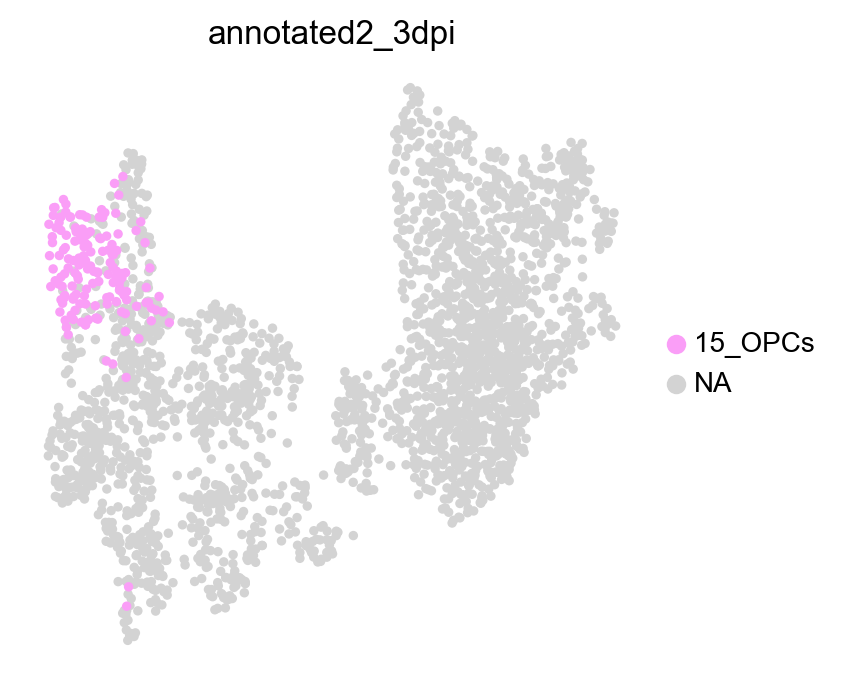

In [118]:
sc.pl.umap(adata_all_oligos_proc, color=['annotated2_3dpi'], legend_fontsize =float(10), groups=['15_OPCs'],
           wspace=0.6, legend_fontweight= 'black', frameon= False, save='_oligos_15_OPCs.png'  )

In [119]:
adata_all_astros_proc.obs['annotated2_3dpi'] = adata_ctr_proce3dpi.obs['annotated2'].astype('category')

In [120]:
adata_all_astros_proc.uns['annotated2_3dpi_colors']=adata_ctr_proce3dpi.uns['annotated2_colors']

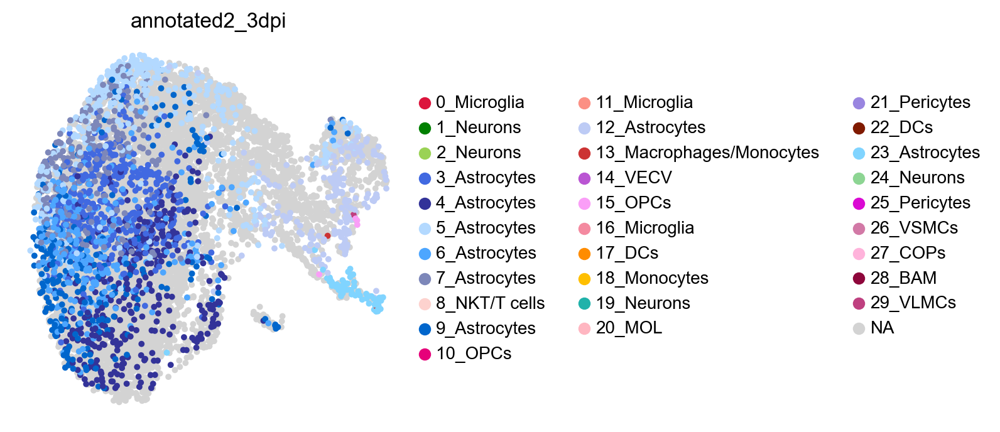

In [121]:
sc.pl.umap(adata_all_astros_proc, color=['annotated2_3dpi'], legend_fontsize =float(10),size=50,
           wspace=0.6, legend_fontweight= 'black', frameon= False  )

In [122]:
adata_all_micro_proc.obs['annotated2_3dpi'] = adata_ctr_proce3dpi.obs['annotated2'].astype('category')

In [123]:
adata_all_micro_proc.uns['annotated2_3dpi_colors']=adata_ctr_proce3dpi.uns['annotated2_colors']

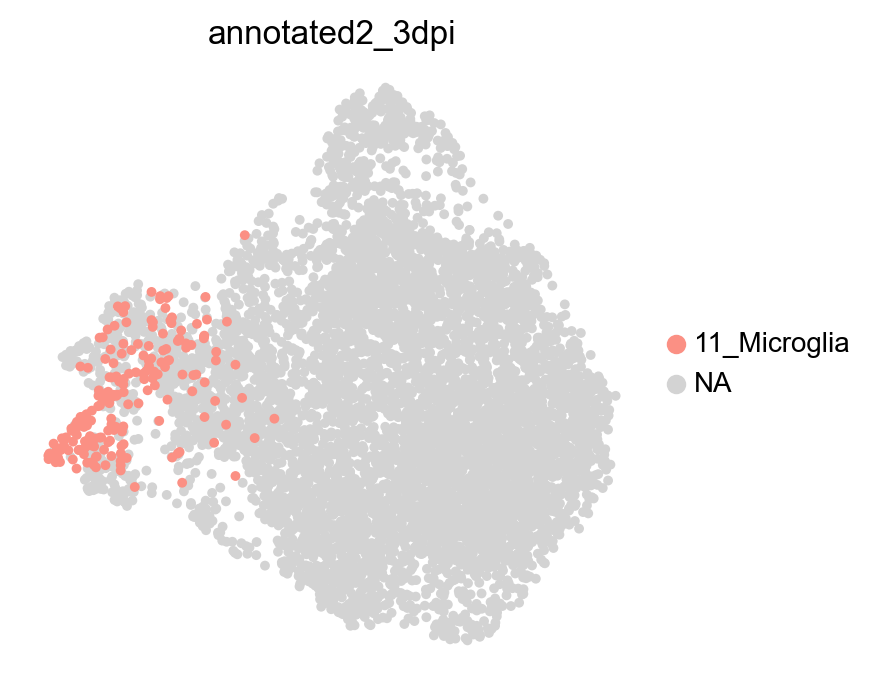

In [124]:
sc.pl.umap(adata_all_micro_proc, color=['annotated2_3dpi'], legend_fontsize =float(10), groups=['11_Microglia'],size=50,
           wspace=0.6, legend_fontweight= 'black', frameon= False, save='_micro_11_Microglia.png'  )

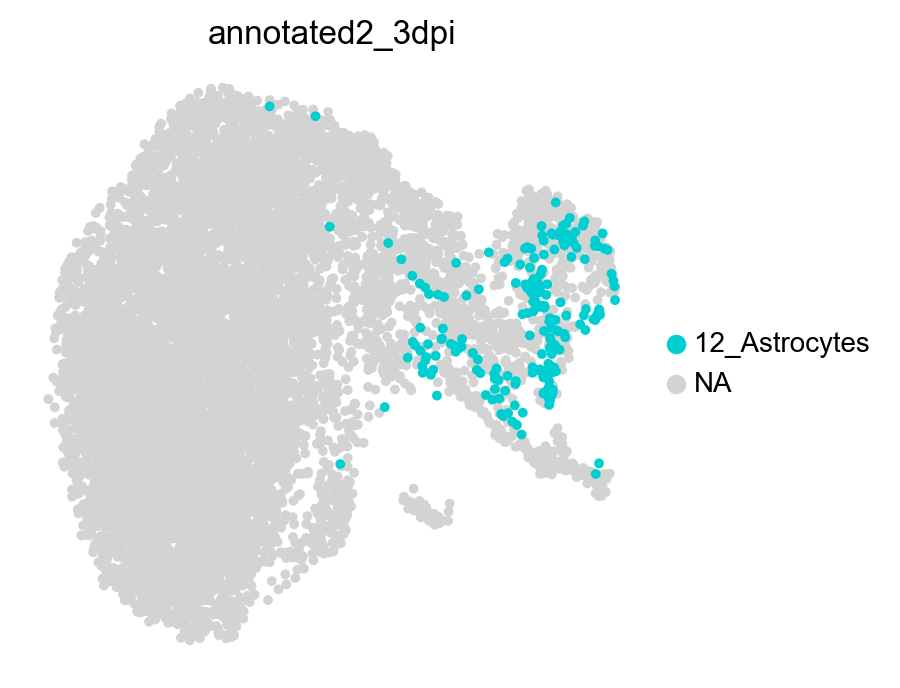

In [125]:
#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_all_astros_proc, color=['annotated2_3dpi'], legend_fontsize =float(10), groups=['12_Astrocytes'],size=50,palette=['#00CED1'],
           wspace=0.6, legend_fontweight= 'black', frameon= False, save='_oligos_12_Astrocytes.png'  )